# Stable Diffusion playground

# Device

In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "2"
# must apparently be placed before importing torch?
device = "cuda"

# Imports

In [15]:
import argparse
from tqdm.auto import trange
from pathlib import Path
from torchvision import transforms
from torchvision.datasets import ImageFolder
from diffusers.optimization import get_scheduler
import torch
import torch.nn.functional as F
import torch.utils.checkpoint
from torch import Tensor
from torchinfo import summary
from diffusers import (
    StableDiffusionPipeline,
    AutoencoderKL,
    DDIMScheduler,
    UNet2DConditionModel,
)
from transformers import CLIPTextModel, CLIPTokenizer
import numpy as np
from PIL import Image
from diffusers.optimization import get_scheduler
from torchview import draw_graph
from math import ceil
import matplotlib.pyplot as plt

# Args

In [3]:
args = argparse.Namespace(
    resolution=128,
    train_batch_size=32,
    train_data_dir="../first-experiments-with-diffusion-models/HF_cstmzd_condgen/data/BBBC021_comp_conc_nice_phen_datalink_high_conc_balanced",
    split="train",
    dataloader_num_workers=4,
    revision=None,
    pretrained_model_name_or_path="stabilityai/stable-diffusion-2-1",
    lr_scheduler="cosine",
    num_train_epochs=100,
    lr_warmup_steps=500, 
    learning_rate=1e-3,
    adam_beta1=0.95,
    adam_beta2=0.999,
    adam_weight_decay=1e-6,
    adam_epsilon=1e-08,
)

# Miscellaneous setup

Instantiate/start/check/download/whatever the **logger**, **repository structure**, **dataset**.

In [4]:
# # -------------------------- WandB -------------------------
# wandb_project_name = args.output_dir.lstrip("experiments/")
# logger = wandb
# logger.info(f"Logging to project {wandb_project_name}")

# # We need to initialize the trackers we use, and also store our configuration.
# # The trackers initializes automatically on the main process.
# tracker_config = dict(vars(args))
# wandb.init(args.tracker_project_name, config=tracker_config)

# ------------------- Repository scruture ------------------
# (
#     image_generation_tmp_save_folder,
#     full_pipeline_save_folder,
#     repo,
# ) = create_repo_structure(args, accelerator)

# ------------------------- Dataset ------------------------
augmentations = transforms.Compose(
    [
        transforms.Resize(
            args.resolution, interpolation=transforms.InterpolationMode.BILINEAR
        ),
        transforms.ToTensor(),
        transforms.Normalize([0.5], [0.5]),  # map to [-1, 1] for SiLU
    ]
)
dataset = ImageFolder(
            root=Path(args.train_data_dir, args.split).as_posix(),
            transform=lambda x: augmentations(x.convert("RGB")),
            target_transform=lambda y: torch.tensor(y).long(),
        )

dataloader = torch.utils.data.DataLoader(
    dataset,
    batch_size=args.train_batch_size,
    shuffle=True,
    num_workers=args.dataloader_num_workers,
)

# Load the pretrained model

There are 2 models actually, the **autoencoder** and the **denoiser**.

Additionally, load the predefined **noise scheduler**.

In [25]:
# ------------------------- Models -------------------------
pipeline = StableDiffusionPipeline.from_pretrained(args.pretrained_model_name_or_path, torch_dtype=torch.float16)
vae = AutoencoderKL.from_pretrained(args.pretrained_model_name_or_path, subfolder="vae", revision=args.revision)
unet = UNet2DConditionModel.from_pretrained(
    args.pretrained_model_name_or_path, subfolder="unet", revision=args.revision
)
text_encoder = CLIPTextModel.from_pretrained(
    args.pretrained_model_name_or_path, subfolder="text_encoder", revision=args.revision
)
tokenizer = CLIPTokenizer.from_pretrained(
    args.pretrained_model_name_or_path, subfolder="tokenizer", revision=args.revision
)

# Move vae, unet and text_encoder to device and cast to weight_dtype
vae.to(device)#, dtype=weight_dtype)
unet.to(device)#, dtype=weight_dtype)
text_encoder.to(device)

# --------------------- Noise scheduler --------------------
noise_scheduler = DDIMScheduler.from_pretrained(args.pretrained_model_name_or_path, subfolder="scheduler")

## Freeze parts of the SD model (or not)

In [26]:
text_encoder.requires_grad_(False)

CLIPTextModel(
  (text_model): CLIPTextTransformer(
    (embeddings): CLIPTextEmbeddings(
      (token_embedding): Embedding(49408, 1024)
      (position_embedding): Embedding(77, 1024)
    )
    (encoder): CLIPEncoder(
      (layers): ModuleList(
        (0-22): 23 x CLIPEncoderLayer(
          (self_attn): CLIPAttention(
            (k_proj): Linear(in_features=1024, out_features=1024, bias=True)
            (v_proj): Linear(in_features=1024, out_features=1024, bias=True)
            (q_proj): Linear(in_features=1024, out_features=1024, bias=True)
            (out_proj): Linear(in_features=1024, out_features=1024, bias=True)
          )
          (layer_norm1): LayerNorm((1024,), eps=1e-05, elementwise_affine=True)
          (mlp): CLIPMLP(
            (activation_fn): GELUActivation()
            (fc1): Linear(in_features=1024, out_features=4096, bias=True)
            (fc2): Linear(in_features=4096, out_features=1024, bias=True)
          )
          (layer_norm2): LayerNorm((1024,

# VAE fine-tuning

## Set up the optimizer & learning rate scheduler

In [7]:
summary(vae, input_size=(args.train_batch_size, 3, args.resolution, args.resolution), depth=5)

/users/biocomp/tboyer/micromamba/envs/diffusion-experiments/lib/python3.10/site-packages/torchinfo/torchinfo.py:477: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  action_fn=lambda data: sys.getsizeof(data.storage()),
/users/biocomp/tboyer/micromamba/envs/diffusion-experiments/lib/python3.10/site-packages/torch/storage.py:665: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return super().__sizeof__() + self.nbytes()


Layer (type:depth-idx)                             Output Shape              Param #
AutoencoderKL                                      [32, 3, 128, 128]         --
├─Encoder: 1-1                                     [32, 8, 16, 16]           --
│    └─Conv2d: 2-1                                 [32, 128, 128, 128]       3,584
│    └─ModuleList: 2-2                             --                        --
│    │    └─DownEncoderBlock2D: 3-1                [32, 128, 64, 64]         --
│    │    │    └─ModuleList: 4-1                   --                        --
│    │    │    │    └─ResnetBlock2D: 5-1           [32, 128, 128, 128]       295,680
│    │    │    │    └─ResnetBlock2D: 5-2           [32, 128, 128, 128]       295,680
│    │    │    └─ModuleList: 4-2                   --                        --
│    │    │    │    └─Downsample2D: 5-3            [32, 128, 64, 64]         147,584
│    │    └─DownEncoderBlock2D: 3-2                [32, 256, 32, 32]         --
│    │    │    └─

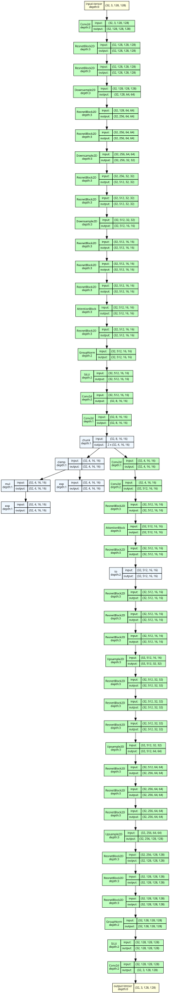

In [8]:
model_graph = draw_graph(vae, input_size=(args.train_batch_size, 3, args.resolution, args.resolution), device=device)
model_graph.visual_graph

In [9]:
# ------------------------ Optimizer -----------------------
optimizer = torch.optim.AdamW(
    vae.parameters(),
    lr=args.learning_rate,
    betas=(args.adam_beta1, args.adam_beta2),
    weight_decay=args.adam_weight_decay,
    eps=args.adam_epsilon,
)

# ----------------- Learning rate scheduler -----------------
lr_scheduler = get_scheduler(
    args.lr_scheduler,
    optimizer=optimizer,
    num_warmup_steps=args.lr_warmup_steps,
    num_training_steps=(len(dataloader) * args.num_train_epochs),
)

## Train

In [10]:
print("***** Running training *****")
print(f"  Num examples = {len(dataset)}")
print(f"  Num batches each epoch = {len(dataloader)}")
print(f"  Num Epochs = {args.num_train_epochs}")
print(f"  Instantaneous batch size per device = {args.train_batch_size}")
print(f"  Batch size = {args.train_batch_size}")

***** Running training *****
  Num examples = 29968
  Num batches each epoch = 937
  Num Epochs = 100
  Instantaneous batch size per device = 32
  Batch size = 32


### Check inputs

In [11]:
def tensor_to_PIL(tensor: Tensor, pipeline):
    assert tensor.ndim == 4
    img_to_show = tensor.clone().detach()
    img_to_show = (img_to_show / 2 + 0.5).clamp(0, 1)
    img_to_show = img_to_show.cpu().permute(0, 2, 3, 1).numpy()
    img_to_show = pipeline.numpy_to_pil(img_to_show)
    if type(img_to_show) == list and len(img_to_show) == 1:
        return img_to_show[0]
    return img_to_show

def print_grid(
    list_PIL_images: list[Image], 
    nb_img_per_row: int = 5, 
    titles=None, 
    first_imgs = None,
    save=None,
):
    if first_imgs is not None:
        list_PIL_images = list_PIL_images[:first_imgs]
        if titles is not None:
            titles = titles[:first_imgs]
    if titles is not None:
        assert len(titles) == len(list_PIL_images)
    num_images = len(list_PIL_images)
    nrows = ceil(num_images / nb_img_per_row)
    fig, axes = plt.subplots(
        nrows=nrows, ncols=nb_img_per_row, figsize=(16, 4*nrows)
    )
    if nrows == 1:
        axes = axes[np.newaxis, :]
    for i in range(num_images):
        row_nb = i // nb_img_per_row
        col_nb = i % nb_img_per_row
        axes[row_nb, col_nb].imshow(list_PIL_images[i])
        axes[row_nb, col_nb].axis('off')
        if titles is not None:
            axes[row_nb, col_nb].set_title(titles[i])
    fig.tight_layout()
    if save is None:
        plt.show()
    else:
        fig.savefig(save)
        fig.clear()

In [12]:
dataset.class_to_idx

{'DMSO': 0, 'latrunculin_B_high_conc': 1}

In [12]:
idx_to_class = {i:j for i, j in enumerate(dataset.classes)}
idx_to_class

{0: 'DMSO', 1: 'latrunculin_B_high_conc'}

0 torch.Size([32, 3, 128, 128]) tensor([1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1,
        1, 0, 1, 1, 1, 1, 1, 1])


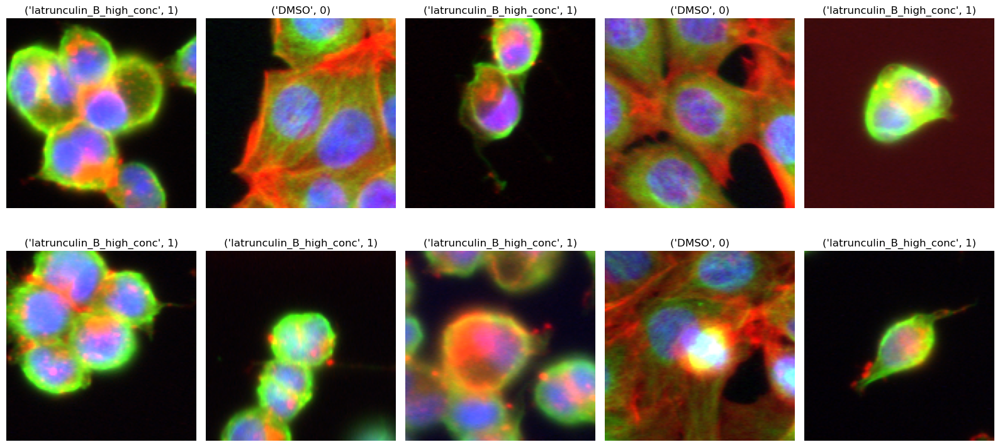

In [14]:
step, batch = next(enumerate(dataloader))
print(step, batch[0].shape, batch[1])
titles = [(idx_to_class[label.item()], label.item()) for label in batch[1]]
print_grid(
    tensor_to_PIL(batch[0], pipeline), 
    titles=titles,
    first_imgs=10
)

### Fine-tune the vae(?)

In [15]:
args.num_train_epochs = 1
loss_func = F.l1_loss

  0%|          | 0/937 [00:00<?, ?it/s]

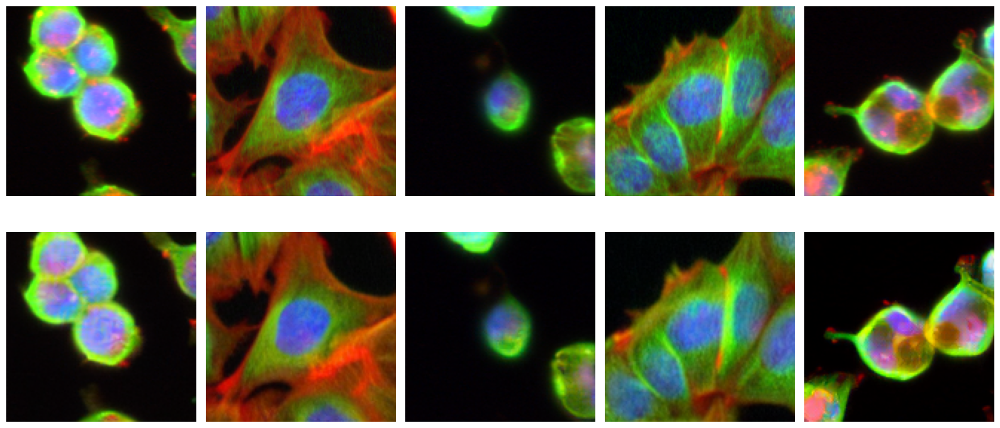

Mean l1_loss loss: 21.906330108642578


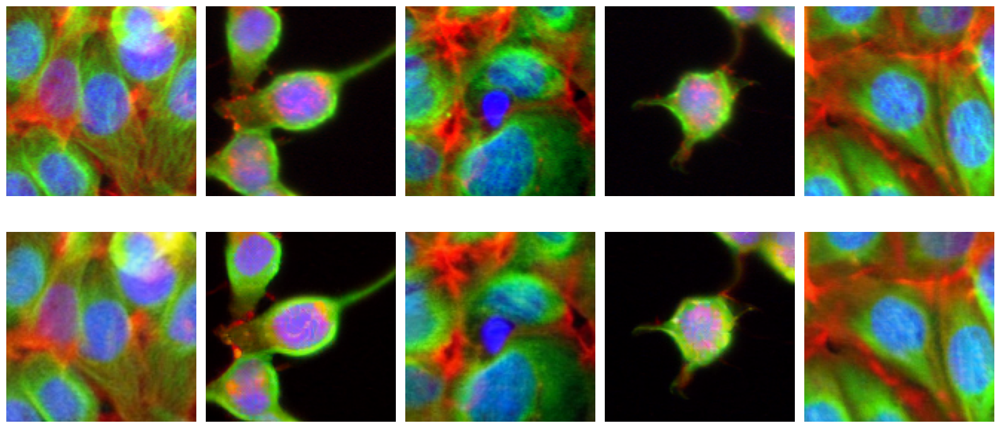

Mean l1_loss loss: 20.84262466430664


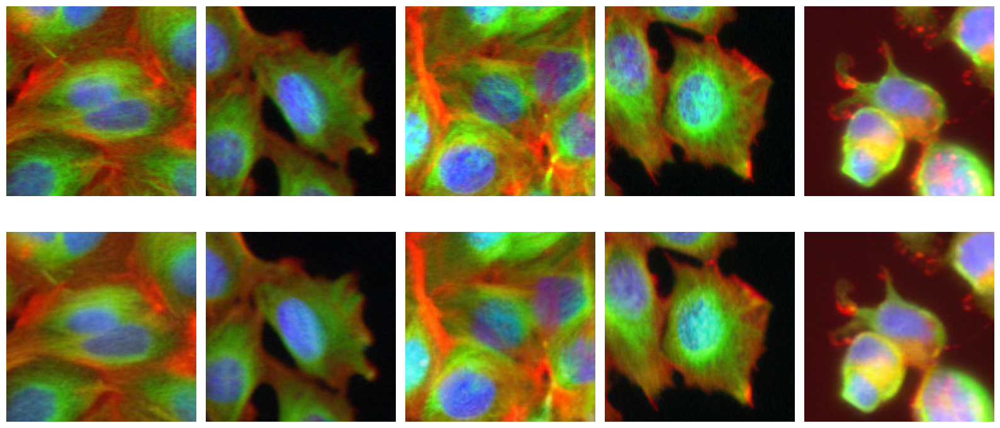

Mean l1_loss loss: 20.31732177734375


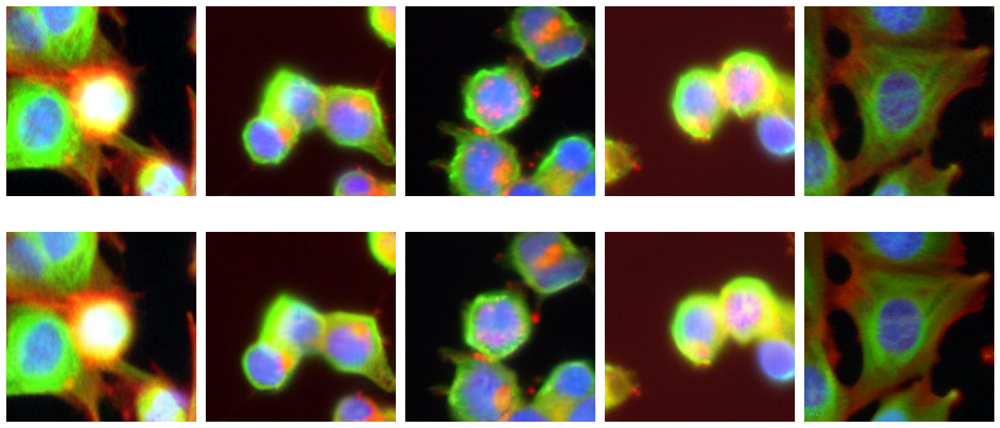

Mean l1_loss loss: 19.222463607788086


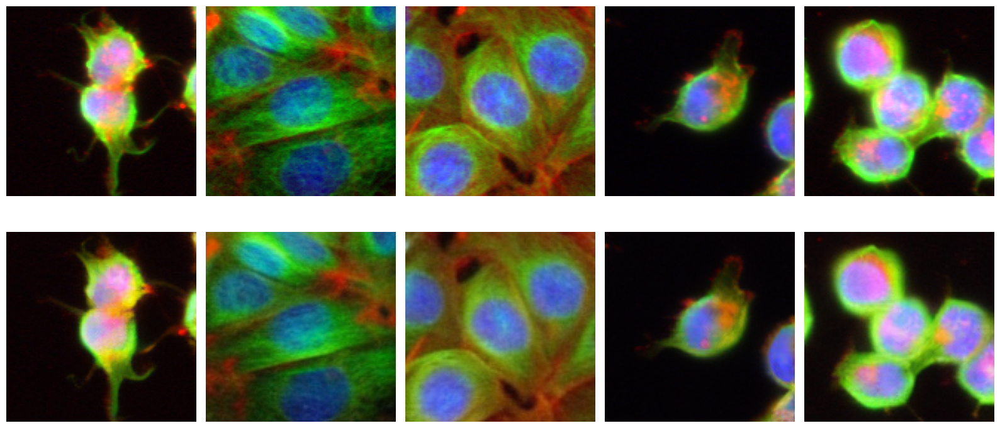

Mean l1_loss loss: 19.17293357849121


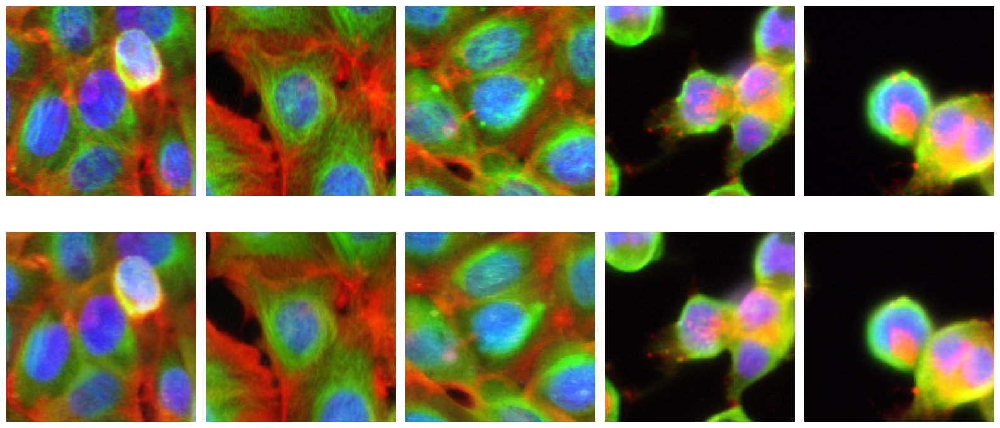

Mean l1_loss loss: 19.34442901611328


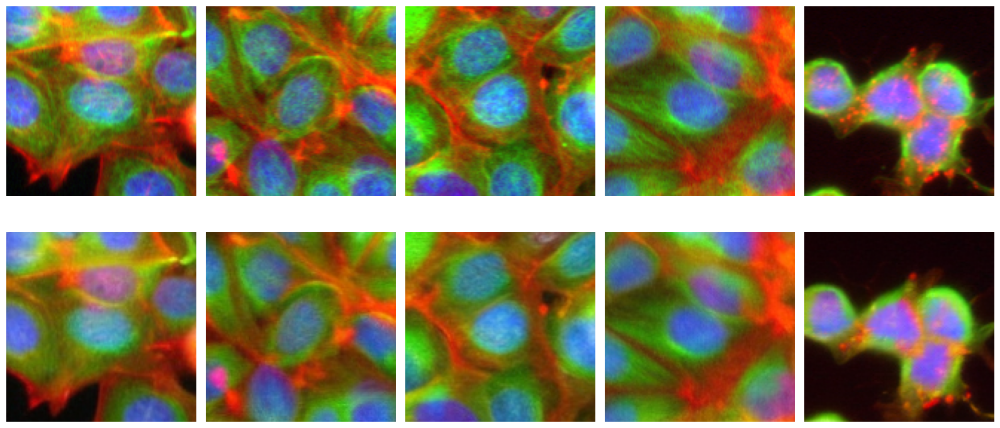

Mean l1_loss loss: 19.366270065307617


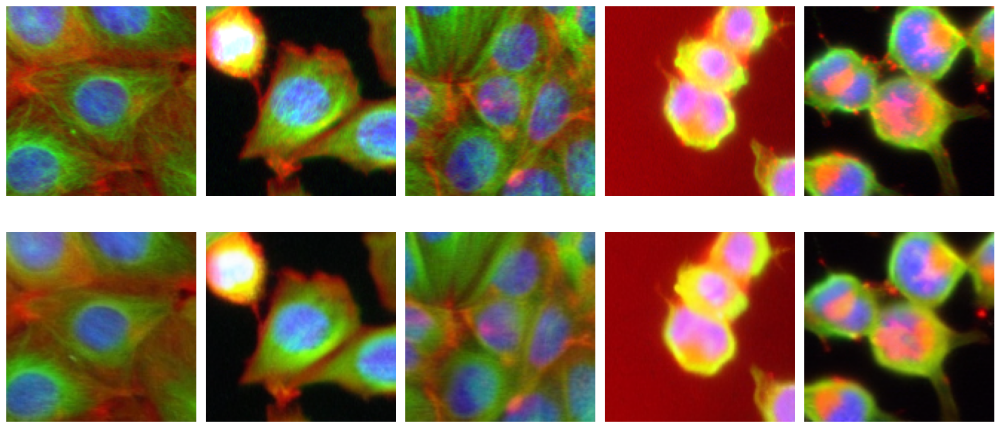

Mean l1_loss loss: 19.322261810302734


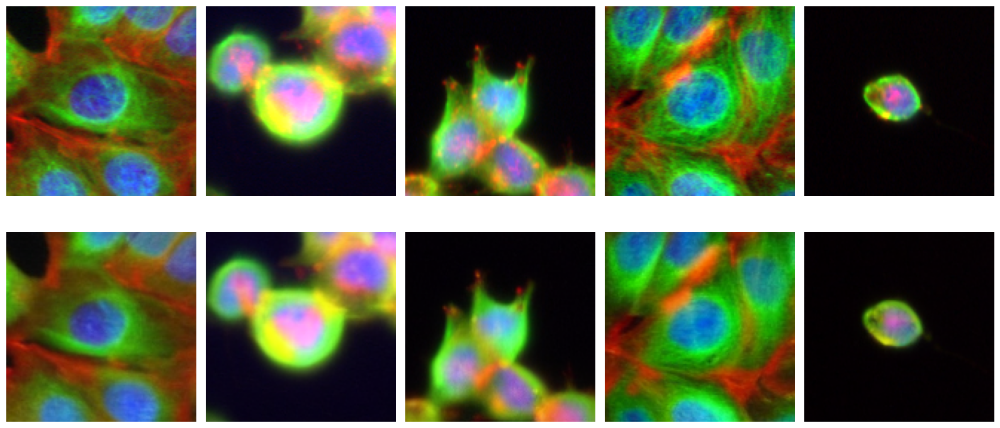

Mean l1_loss loss: 17.82482147216797


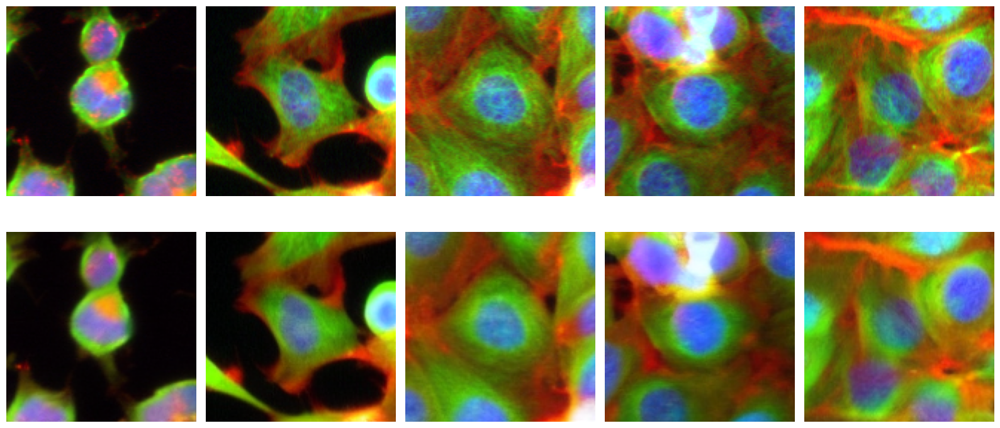

Mean l1_loss loss: 18.840879440307617


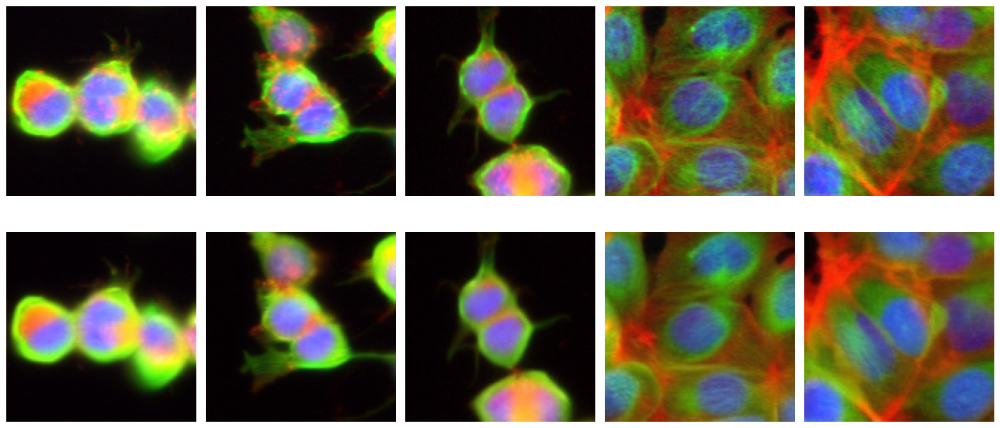

Mean l1_loss loss: 18.123859405517578


In [16]:
progress_bar = trange(args.num_train_epochs * len(dataloader))

loss_list = []

# ---------------------- Training loop ---------------------
for epoch in range(args.num_train_epochs):
    for step, batch in enumerate(dataloader):
        vae.train()
        progress_bar.set_description(f"Epoch {epoch} | batch {step}/{len(dataloader)}")
        
        # Get the images
        img = batch[0].to(device)
        
        # Forward pass in the vae
        reco = vae(img).sample

        # Compute loss
        # only L2/L1 for now; TODO? add perceptual?
        loss = loss_func(reco, img)

        loss.backward()
        optimizer.step()
        lr_scheduler.step()
        optimizer.zero_grad()
        
        loss_value = loss.item()
        loss_list.append(loss_value)
    
        logs = {"loss": loss_value, "lr": lr_scheduler.get_last_lr()[0]}
        progress_bar.set_postfix(**logs)
        progress_bar.update()
            
        # display some reconstructed images from the last batch
        vae.eval()
        with torch.no_grad():
            # print("Original images / Reconstructed images")
            reco = vae(img).sample
            print_grid(
                tensor_to_PIL(img, pipeline)[:5] + tensor_to_PIL(reco, pipeline)[:5], 
                # save=f"img_vs_reco.png"
            )
            reco_err = torch.mean(torch.linalg.vector_norm(reco - img, dim=(1, 2, 3)))
            print(f"Mean {loss_func.__name__} loss: {reco_err}")
            
        if step >= 10:
            break

progress_bar.close()

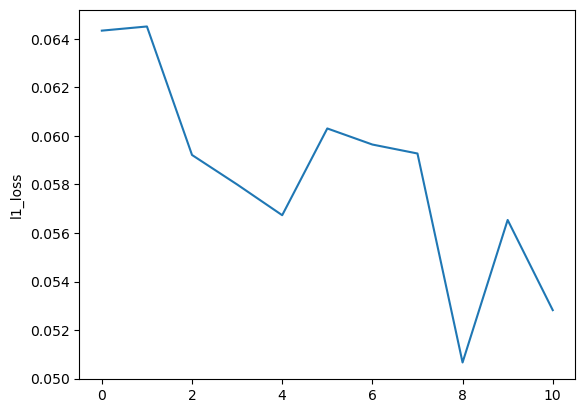

In [17]:
plt.plot(loss_list)
plt.ylabel(loss_func.__name__)
# plt.xlabel("...")
plt.show()

The pretrained vae already gives excellent results, even without any fine-tuning!
The images are quite blurred though.

# Denoiser fine-tuning

## Set up the optimizer & learning rate scheduler

In [18]:
tokens = tokenizer(
    ["test"] * 32, max_length=tokenizer.model_max_length, padding="max_length", truncation=True, return_tensors="pt"
).input_ids.to(device)

with torch.no_grad():
    fake_img = torch.randn((args.train_batch_size, 3, args.resolution, args.resolution), device=device)
    latents = vae.encode(fake_img)
    latents = latents.latent_dist.sample()
    latents_shape = latents.shape

summary(
    unet, 
    input_size=latents_shape, 
    depth=5, 
    encoder_hidden_states=text_encoder(tokens)[0],
    timestep=15 #torch.tensor([0] * args.train_batch_size).to(device),
)

/users/biocomp/tboyer/micromamba/envs/diffusion-experiments/lib/python3.10/site-packages/torchinfo/torchinfo.py:477: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  action_fn=lambda data: sys.getsizeof(data.storage()),
/users/biocomp/tboyer/micromamba/envs/diffusion-experiments/lib/python3.10/site-packages/torch/storage.py:665: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return super().__sizeof__() + self.nbytes()


Layer (type:depth-idx)                                            Output Shape              Param #
UNet2DConditionModel                                              [32, 4, 16, 16]           --
├─Timesteps: 1-1                                                  [32, 320]                 --
├─TimestepEmbedding: 1-2                                          [32, 1280]                --
│    └─Linear: 2-1                                                [32, 1280]                410,880
│    └─SiLU: 2-2                                                  [32, 1280]                --
│    └─Linear: 2-3                                                [32, 1280]                1,639,680
├─Conv2d: 1-3                                                     [32, 320, 16, 16]         11,840
├─ModuleList: 1-4                                                 --                        --
│    └─CrossAttnDownBlock2D: 2-4                                  [32, 320, 8, 8]           --
│    │    └─ModuleList: 3-3  

In [30]:
args.learning_rate = 1e-3

In [31]:
# ------------------------ Optimizer -----------------------
optimizer = torch.optim.AdamW(
    unet.parameters(),
    lr=args.learning_rate,
    betas=(args.adam_beta1, args.adam_beta2),
    weight_decay=args.adam_weight_decay,
    eps=args.adam_epsilon,
)

# ----------------- Learning rate scheduler -----------------
lr_scheduler = get_scheduler(
    args.lr_scheduler,
    optimizer=optimizer,
    num_warmup_steps=args.lr_warmup_steps,
    num_training_steps=(len(dataloader) * args.num_train_epochs),
)

# Train

In [32]:
print("***** Running training *****")
print(f"  Num examples = {len(dataset)}")
print(f"  Num batches each epoch = {len(dataloader)}")
print(f"  Num Epochs = {args.num_train_epochs}")
print(f"  Instantaneous batch size per device = {args.train_batch_size}")
print(f"  Batch size = {args.train_batch_size}")

***** Running training *****
  Num examples = 29968
  Num batches each epoch = 937
  Num Epochs = 100
  Instantaneous batch size per device = 32
  Batch size = 32


### Fine-tune the unet

**But first freeze the vae!**

In [33]:
vae.requires_grad_(False)

AutoencoderKL(
  (encoder): Encoder(
    (conv_in): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (down_blocks): ModuleList(
      (0): DownEncoderBlock2D(
        (resnets): ModuleList(
          (0-1): 2 x ResnetBlock2D(
            (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
            (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (norm2): GroupNorm(32, 128, eps=1e-06, affine=True)
            (dropout): Dropout(p=0.0, inplace=False)
            (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (nonlinearity): SiLU()
          )
        )
        (downsamplers): ModuleList(
          (0): Downsample2D(
            (conv): Conv2d(128, 128, kernel_size=(3, 3), stride=(2, 2))
          )
        )
      )
      (1): DownEncoderBlock2D(
        (resnets): ModuleList(
          (0): ResnetBlock2D(
            (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
            (c

In [36]:
progress_bar = trange(args.num_train_epochs * len(dataloader))
loss_list = []

for epoch in range(args.num_train_epochs):
    unet.train()
    for step, batch in enumerate(dataloader):
        # Convert images to latent space
        img = batch[0].to(device)
        latents = vae.encode(img).latent_dist.sample()
        latents = latents * vae.config.scaling_factor # ?

        # Sample noise that we'll add to the latents
        noise = torch.randn_like(latents)
        bsz = latents.shape[0]
        
        # Sample a random timestep for each image
        timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (bsz,), device=latents.device)
        timesteps = timesteps.long()

        # Add noise to the latents according to the noise magnitude at each timestep
        # (this is the forward diffusion process)
        noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

        # Get the text embedding for conditioning
        titles = [idx_to_class[label.item()] for label in batch[1]]
        tokens = tokenizer(
            [""] * args.train_batch_size,
            max_length=tokenizer.model_max_length, 
            padding="max_length", 
            truncation=True, 
            return_tensors="pt"
        ).input_ids.to(device)
        # other possibility: actually use some text like "hyperrealistical biological image..." 
        # or remove the text conditionning entirely
        encoder_hidden_states = text_encoder(tokens)[0]

        # Predict the noise residual
        model_pred = unet(
            noisy_latents,
            timesteps,
            encoder_hidden_states=encoder_hidden_states,
        ).sample

        # Get the target for loss depending on the prediction type
        if noise_scheduler.config.prediction_type == "epsilon":
            target = noise
        elif noise_scheduler.config.prediction_type == "v_prediction":
            target = noise_scheduler.get_velocity(latents, noise, timesteps)
        else:
            raise ValueError(f"Unknown prediction type {noise_scheduler.config.prediction_type}")
        loss = F.mse_loss(model_pred.float(), target.float(), reduction="mean")

        # Compute gradients and optimize
        loss.backward()
        optimizer.step()
        lr_scheduler.step()
        optimizer.zero_grad()

        # Update progress bar and show metrics
        progress_bar.update()
        loss_value = loss.item()
        loss_list.append(loss_value)
        logs = {"loss": loss_value, "lr": lr_scheduler.get_last_lr()[0]}
        progress_bar.set_postfix(**logs)
    
    # if validate:
        # unet.eval()
        # ...

  0%|          | 0/93700 [00:00<?, ?it/s]

KeyboardInterrupt: 

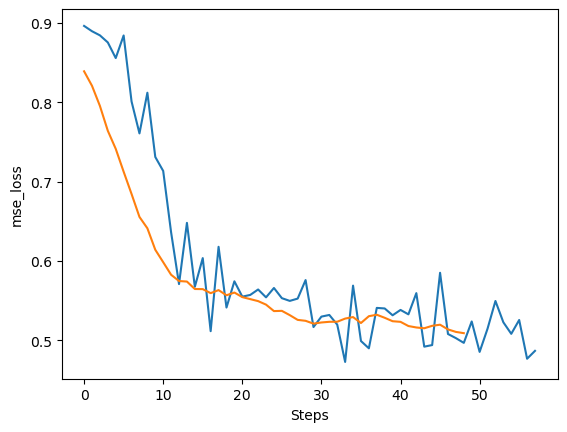

In [37]:
plt.plot(loss_list, label="loss")
window = 10
loss_list_avg = []
for ind in range(len(loss_list) - window + 1):
    loss_list_avg.append(np.mean(loss_list[ind : ind + window]))
plt.plot(loss_list_avg, label="loss_avg")
plt.ylabel(F.mse_loss.__name__)
plt.xlabel("Steps")
plt.show()

In [38]:
pipeline = StableDiffusionPipeline.from_pretrained(
    args.pretrained_model_name_or_path,
    vae=vae,
    text_encoder=text_encoder,
    tokenizer=tokenizer,
    unet=unet,
    safety_checker=None,
    revision=args.revision,
)
pipeline.scheduler = DDIMScheduler.from_config(pipeline.scheduler.config)
pipeline = pipeline.to(device)

In [41]:
out = pipeline(prompt=[""] * 5)

  0%|          | 0/50 [00:00<?, ?it/s]

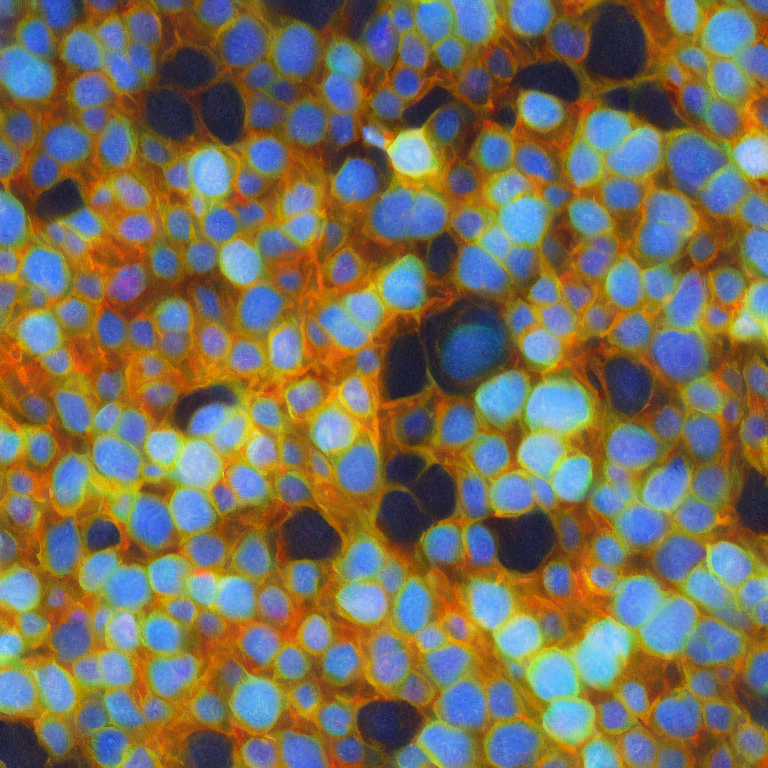

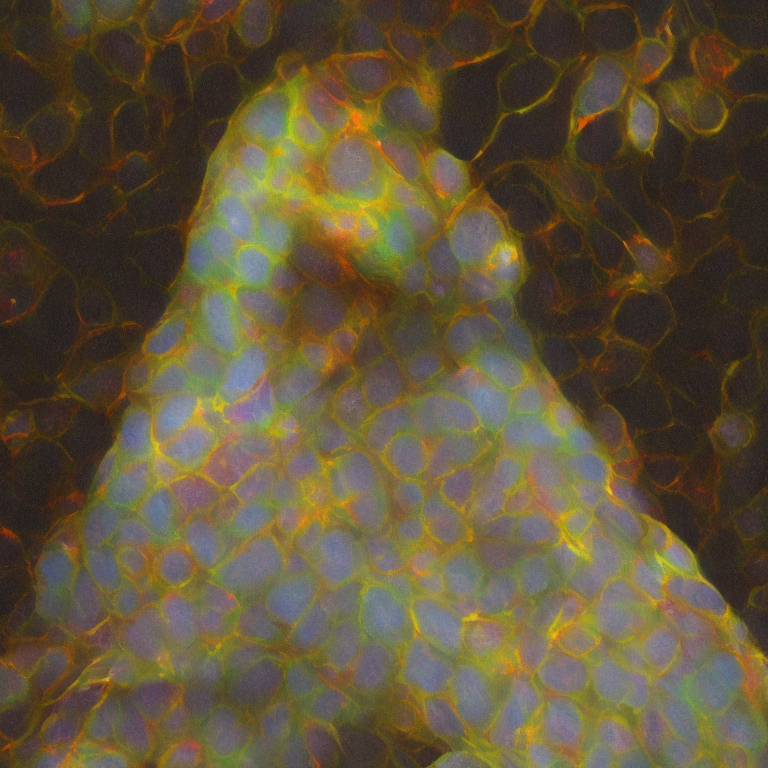

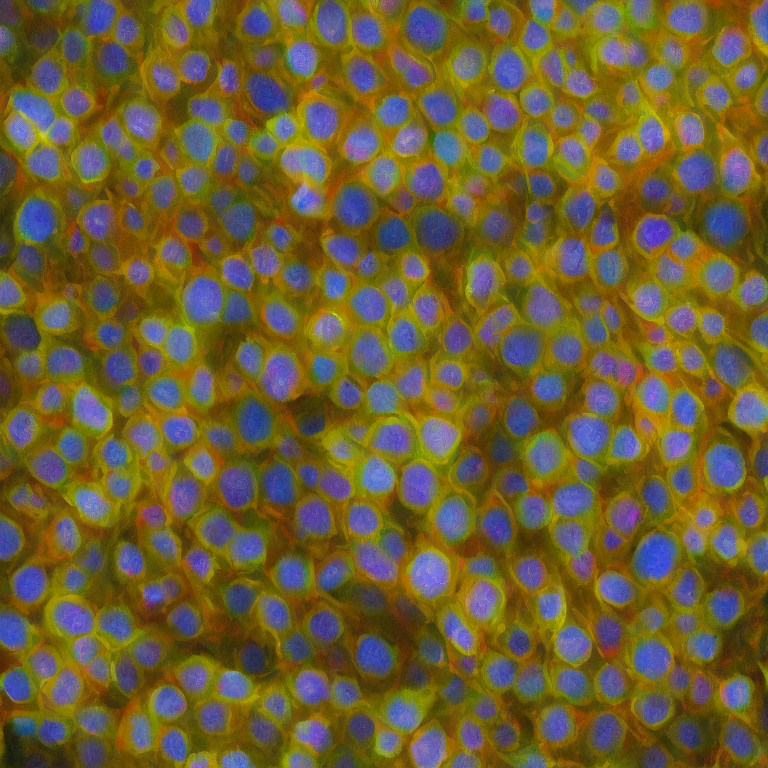

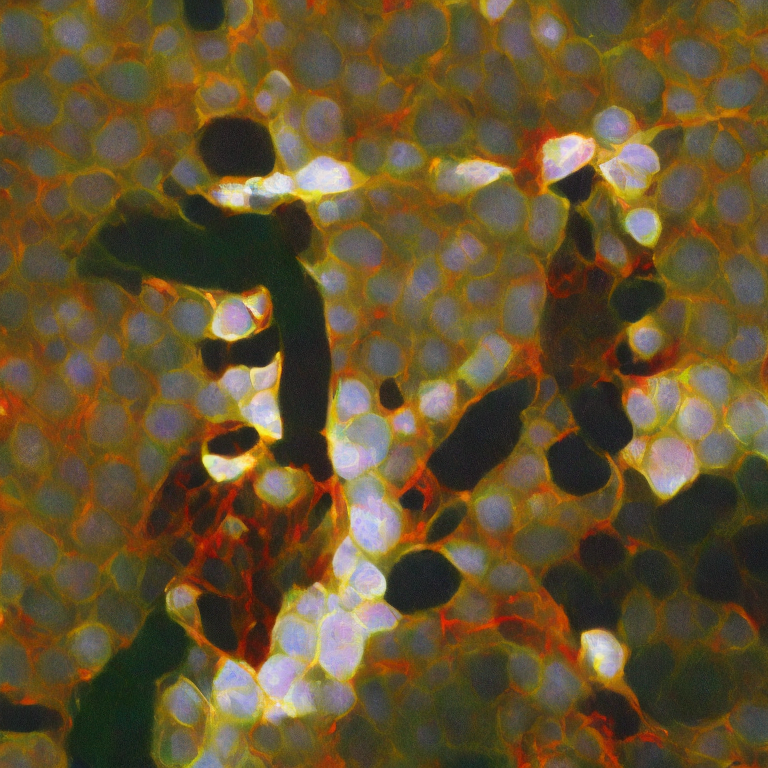

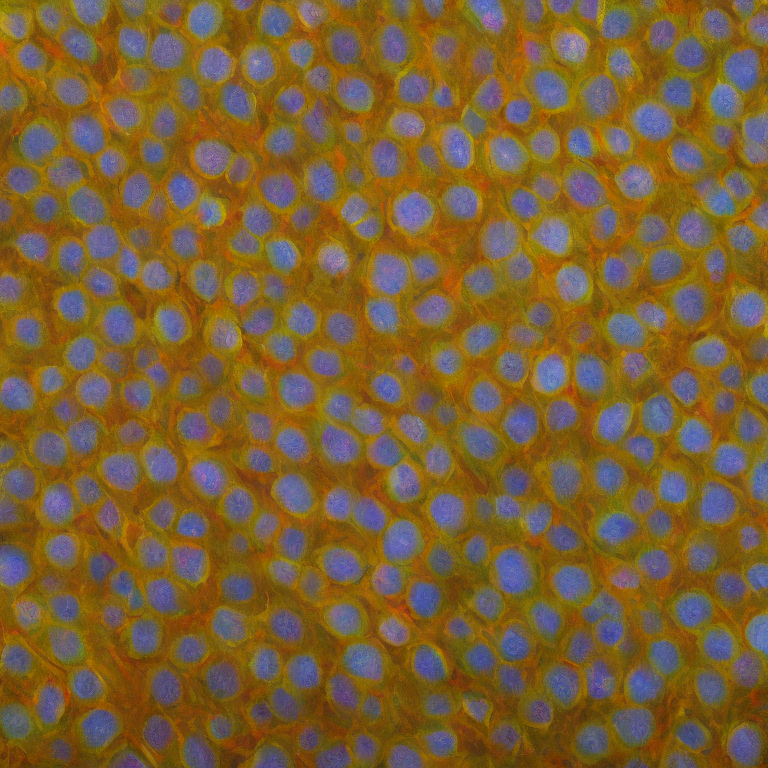

In [42]:
for img in out.images:
    display(img)